## **<h2 style="color:#008080; font-weight:bold;">California Housing Price</h2>**

[Sumber data California Housing Price](https://www.kaggle.com/datasets/camnugent/california-housing-prices) 

### **Contents**

1. Business Problem Understanding
2. Data Understanding
3. Data Preprocessing
4. Modeling
5. Conclusion
6. Recommendation

****

## <h1 style="color:#008080;"><b>1. Business Problem Understanding 



### **Context**

Dataset yang digunakan merupakan data hasil sensus tahun 1990 di negara bagian **California, Amerika Serikat**, yang memuat informasi demografis seperti pendapatan, jumlah populasi, kepadatan rumah tangga, serta kondisi properti seperti jumlah kamar, usia rumah, dan lokasi geografis (latitude & longitude). Meskipun data ini tidak merepresentasikan kondisi terkini, data ini sangat cocok digunakan sebagai bahan pembelajaran dan eksperimen dalam membangun model prediktif harga rumah.

---

### **Problem Statement**

Salah satu tantangan utama bagi **developer perumahan** adalah menentukan **harga jual properti** yang sesuai dengan lokasi dan kondisi demografis di sekitarnya. Kesalahan dalam penetapan harga—misalnya membangun perumahan elit di kawasan berpendapatan rendah, atau sebaliknya—dapat berdampak buruk pada penjualan dan profitabilitas. Oleh karena itu, penting bagi developer untuk memiliki **alat bantu prediktif** dalam menentukan harga rumah yang wajar dan sesuai dengan target pasarnya.

---

### **Goals**

Tujuan dari pemodelan ini adalah untuk:

- **Memprediksi harga jual rumah** berdasarkan fitur-fitur relevan yang tersedia dalam dataset.
- Menyediakan **insight berbasis data** bagi developer dalam menentukan **lokasi strategis** dan **rentang harga** yang sesuai dengan kondisi pasar lokal.
- Menghasilkan model regresi yang akurat dan andal, yang dapat digunakan sebagai **alat bantu keputusan** dalam pengembangan proyek perumahan di California.

---

### **Analytic Approach**

Pendekatan yang digunakan adalah:

- **Eksplorasi dan analisis data** untuk memahami korelasi antar fitur dan karakteristik distribusi masing-masing variabel.
- Menggunakan pendekatan **supervised learning (regresi)** untuk memodelkan hubungan antara fitur properti/demografis dengan harga rumah.
- Melakukan **evaluasi model** untuk memilih model terbaik berdasarkan metrik performa.
- Menyediakan visualisasi dan interpretasi hasil model untuk mendukung pengambilan keputusan bisnis.

---

### **Evaluation Metrics**

Model regresi akan dievaluasi menggunakan beberapa metrik utama, yaitu:

- **RMSE (Root Mean Squared Error)**: Mengukur akar dari rata-rata kuadrat kesalahan. Sensitif terhadap outlier.
- **MAE (Mean Absolute Error)**: Mengukur rata-rata selisih absolut antara nilai prediksi dan aktual.
- **MAPE (Mean Absolute Percentage Error)**: Mengukur rata-rata persentase kesalahan relatif terhadap nilai aktual.
- **R-squared (R²)**: Mengukur proporsi variansi data target yang dapat dijelaskan oleh model. Hanya relevan untuk model linier.

Semakin kecil nilai RMSE, MAE, dan MAPE, maka semakin baik performa model dalam memprediksi harga rumah. Jika model final yang digunakan adalah model linear, maka nilai R² juga akan menjadi indikator tambahan untuk menilai **goodness of fit**.


# <h1 style="color:#008080;"><b>2. Data Understanding</b></h1>

- Data ini berkaitan dengan rumah-rumah yang berada di beberapa distrik di California, berdasarkan hasil **sensus tahun 1990**.  
- Setiap baris data merepresentasikan informasi mengenai properti dan lingkungan di sekitarnya, termasuk kondisi geografis dan demografis dari suatu area (blok).

---

### **Informasi Atribut**

| **Atribut**           | **Tipe Data** | **Deskripsi**                                                                 |
|------------------------|---------------|-------------------------------------------------------------------------------|
| `longitude`            | Float         | Menunjukkan posisi geografis rumah ke arah **barat**; semakin besar nilainya, semakin ke barat lokasinya. |
| `latitude`             | Float         | Menunjukkan posisi geografis rumah ke arah **utara**; semakin besar nilainya, semakin ke utara lokasinya. |
| `housingMedianAge`     | Float         | Usia median bangunan rumah dalam satu blok; semakin kecil nilainya, bangunan cenderung lebih baru. |
| `totalRooms`           | Float         | Jumlah total seluruh ruangan dalam satu blok. |
| `totalBedrooms`        | Float         | Jumlah total seluruh kamar tidur dalam satu blok. |
| `population`           | Float         | Jumlah total populasi (penduduk) yang tinggal dalam satu blok. |
| `households`           | Float         | Jumlah total rumah tangga dalam satu blok (satu rumah tangga dapat terdiri dari beberapa orang yang tinggal bersama). |
| `medianIncome`         | Float         | Pendapatan median dari rumah tangga dalam satu blok (dalam satuan puluhan ribu Dolar AS). |
| `medianHouseValue`     | Float         | Nilai median rumah dalam satu blok (dalam satuan Dolar AS). |
| `oceanProximity`       | Object        | Letak atau jarak rumah terhadap laut/samudra (misalnya: dekat laut, jauh dari laut, dll). |

In [22]:
# Import library yang dibutuhkan untuk eksplorasi dataset

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [23]:
# Load Dataset

df = pd.read_csv('data_california_house.csv')
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,INLAND,47500.0
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,NEAR BAY,100000.0
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,<1H OCEAN,285800.0
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,<1H OCEAN,175000.0
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,INLAND,59200.0
...,...,...,...,...,...,...,...,...,...,...
14443,-121.26,38.27,20.0,1314.0,229.0,712.0,219.0,4.4125,INLAND,144600.0
14444,-120.89,37.48,27.0,1118.0,195.0,647.0,209.0,2.9135,INLAND,159400.0
14445,-121.90,36.58,31.0,1431.0,NaN,704.0,393.0,3.1977,NEAR OCEAN,289300.0
14446,-117.93,33.62,34.0,2125.0,498.0,1052.0,468.0,5.6315,<1H OCEAN,484600.0


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14448 entries, 0 to 14447
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           14448 non-null  float64
 1   latitude            14448 non-null  float64
 2   housing_median_age  14448 non-null  float64
 3   total_rooms         14448 non-null  float64
 4   total_bedrooms      14311 non-null  float64
 5   population          14448 non-null  float64
 6   households          14448 non-null  float64
 7   median_income       14448 non-null  float64
 8   ocean_proximity     14448 non-null  object 
 9   median_house_value  14448 non-null  float64
dtypes: float64(9), object(1)
memory usage: 1.1+ MB


#### **Exploratory Data Analysis**

In [25]:
# duplikasi data, agar tidak tidak mempengaruhi data asli

df_model = df.copy()

In [26]:
import folium
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, to_hex

# Colormap pink ke merah tua
colors = ['#FFC0CB', '#8B0000']
colormap = LinearSegmentedColormap.from_list("pink_darkred", colors)

# Normalisasi populasi
pop_min = df['population'].min()
pop_max = df['population'].max()
norm_pop = (df['population'] - pop_min) / (pop_max - pop_min) if pop_max != pop_min else df['population'] * 0

# Titik tengah peta
center_lat = df['latitude'].mean()
center_lon = df['longitude'].mean()

# Inisialisasi peta (non-interaktif)
map_pop = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=6,
    scrollWheelZoom=False,
    dragging=False,
    zoom_control=False,
    doubleClickZoom=False,
    touchZoom=False
)

# Tambahkan lingkaran
for idx, row in df.iterrows():
    color = to_hex(colormap(norm_pop.iloc[idx]))
    folium.Circle(
        location=[row['latitude'], row['longitude']],
        radius=max(row['population'] / 50, 1000),
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=folium.Popup(
            f"<b>Populasi:</b> {int(row['population'])}<br>"
            f"<b>Lokasi:</b> ({row['latitude']:.2f}, {row['longitude']:.2f})",
            max_width=300
        )
    ).add_to(map_pop)

# Tampilkan peta
map_pop


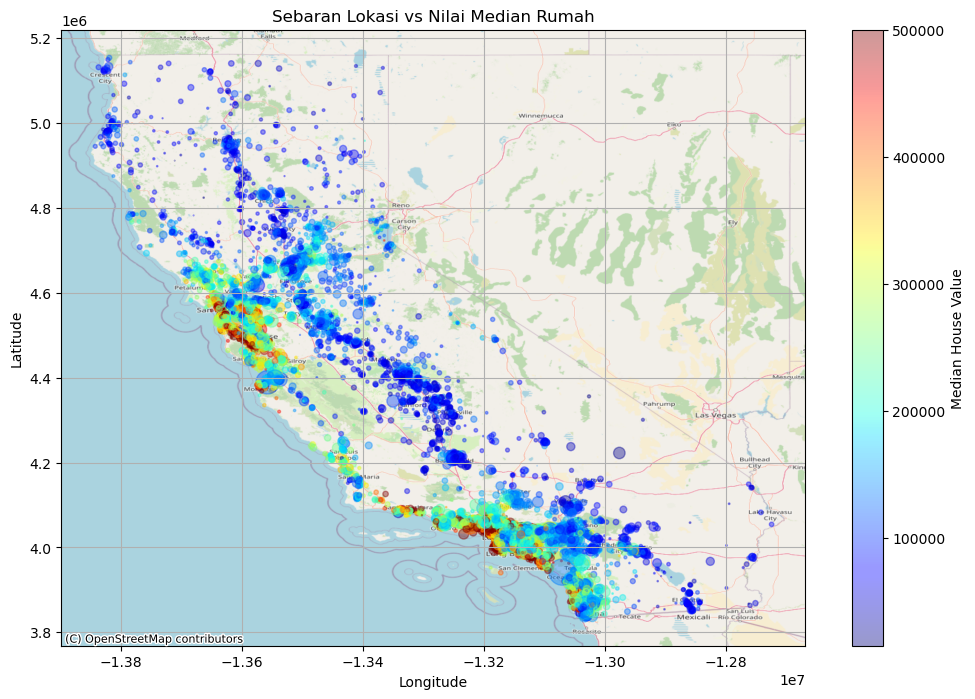

In [27]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from shapely.geometry import Point

# Misal df_model adalah DataFrame yang sudah Anda punya
# df_model = pd.read_csv("nama_file.csv")  # Sesuaikan dengan data Anda

# Buat GeoDataFrame dari df_model
geometry = [Point(xy) for xy in zip(df_model["longitude"], df_model["latitude"])]
gdf = gpd.GeoDataFrame(df_model, geometry=geometry, crs="EPSG:4326")

# Proyeksikan ke EPSG:3857 (web mercator, yang dibutuhkan contextily)
gdf = gdf.to_crs(epsg=3857)

# Plot
fig, ax = plt.subplots(figsize=(12, 8))

# Scatter plot rumah
sc = ax.scatter(
    gdf.geometry.x,
    gdf.geometry.y,
    alpha=0.4,
    s=gdf["population"] / 100,
    c=gdf["median_house_value"],
    cmap="jet"
)

# Tambahkan colorbar
cbar = plt.colorbar(sc, ax=ax)
cbar.set_label("Median House Value")

# Tambahkan peta tile dari contextily (ganti provider agar tidak error)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

# Judul dan label
ax.set_title("Sebaran Lokasi vs Nilai Median Rumah")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
plt.grid(True)
plt.show()


## Insight dari Sebaran Lokasi vs Nilai Median Rumah di California

Berdasarkan scatter plot sebelumnya:

- Harga rumah tertinggi terkonsentrasi di wilayah pesisir barat, terutama di sekitar Los Angeles dan San Francisco.
- Area dengan longitude kecil dan latitude antara 33–38 (wilayah pesisir California) memiliki nilai median rumah yang tinggi.
- Wilayah pedalaman (longitude lebih besar, jauh dari laut) umumnya memiliki harga rumah yang lebih rendah.
- Populasi padat (digambarkan dengan lingkaran lebih besar pada plot) cenderung berada di wilayah dengan harga rumah tinggi, menandakan permintaan yang tinggi di area tersebut.
- Faktor lokasi geografis, seperti kedekatan dengan laut dan kota besar, sangat memengaruhi nilai median rumah di California.


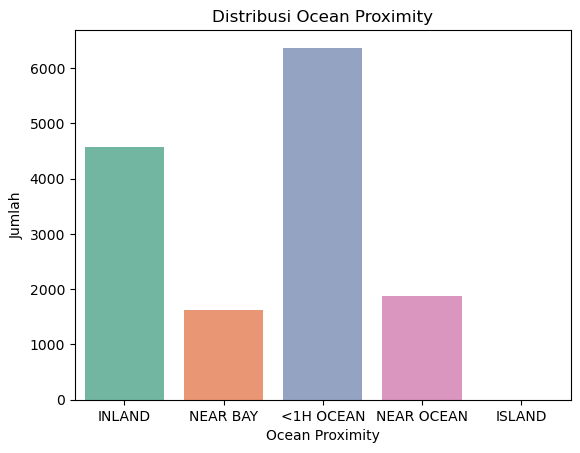

In [28]:
sns.countplot(data=df_model, x='ocean_proximity', palette='Set2')
plt.title('Distribusi Ocean Proximity')
plt.xlabel('Ocean Proximity')
plt.ylabel('Jumlah')
plt.show()

## Insight dari Distribusi Ocean Proximity

Berdasarkan visualisasi distribusi `ocean_proximity`:

- Mayoritas penduduk California tinggal di area yang berjarak kurang dari 1 jam ke laut (`<1H OCEAN`) dan area yang tergolong `INLAND` (jauh dari laut).
- Kategori `<1H OCEAN` mendominasi, menunjukkan preferensi masyarakat untuk tinggal di lokasi yang dekat dengan pantai, sejalan dengan gaya hidup dan daya tarik kawasan pesisir California.
- Area `NEAR BAY` dan `NEAR OCEAN` memiliki jumlah penduduk yang lebih sedikit, kemungkinan karena keterbatasan lahan atau harga properti yang lebih tinggi di kawasan tersebut.
- Sangat sedikit distrik yang benar-benar berada di tepi laut (`ISLAND`), menandakan area ini cukup eksklusif atau terbatas.
- Distribusi ini menegaskan bahwa faktor kedekatan dengan laut merupakan salah satu pertimbangan utama dalam pemilihan lokasi tempat tinggal di California.

In [29]:
df_model.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,14448.000000,14448.000000,14448.000000,14448.000000,14311.000000,14448.000000,14448.000000,14448.000000,14448.000000
mean,-119.566647,35.630093,28.618702,2640.132683,538.260709,1425.157323,499.508929,3.866667,206824.624516
std,2.006587,2.140121,12.596694,2191.612441,423.577544,1149.580157,383.098390,1.891158,115365.476182
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1451.000000,295.000000,784.000000,279.000000,2.570600,119600.000000
50%,-118.490000,34.260000,29.000000,2125.000000,435.000000,1165.000000,410.000000,3.539100,180000.000000
75%,-118.000000,37.710000,37.000000,3148.000000,647.000000,1724.000000,604.000000,4.736100,263900.000000
max,-114.310000,41.950000,52.000000,32627.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


Berikut insight dari hasil `df_model.describe()`:

- **Central Tendency**: Nilai rata-rata (`mean`) dan median (`50%`) pada fitur-fitur seperti `median_income`, `housing_median_age`, dan `median_house_value` menunjukkan distribusi data yang cukup lebar.
- **Dispersi**: Rentang antara nilai minimum (`min`) dan maksimum (`max`) pada hampir semua fitur sangat besar, misalnya pada `total_rooms`, `population`, dan `median_house_value`. Hal ini menandakan adanya variasi yang tinggi dan kemungkinan distribusi data tidak normal.
- **Outlier**: Nilai maksimum pada beberapa fitur (misal `total_rooms`, `population`) jauh lebih besar dari nilai rata-rata dan persentil ke-75 (`75%`), mengindikasikan adanya outlier yang signifikan.
- **Missing Value**: Pada fitur `total_bedrooms`, jumlah data non-null lebih sedikit dibandingkan fitur lain, menandakan adanya missing value yang perlu ditangani pada tahap preprocessing.
- **Distribusi**: Standar deviasi (`std`) yang besar pada beberapa fitur juga memperkuat indikasi bahwa data memiliki sebaran yang lebar dan tidak simetris.

Insight ini penting untuk menentukan langkah preprocessing, seperti penanganan outlier, normalisasi, dan imputasi missing value sebelum modeling.

In [51]:
# Pilih hanya kolom numerik dari df_model, tanpa longitude dan latitude
df_numerik = df_model.select_dtypes(include='number').drop(['longitude', 'latitude'], axis=1)
df_numerik.head()

,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,52.0,112.0,28.0,193.0,40.0,1.9750,47500.0
1,43.0,1017.0,328.0,836.0,277.0,2.2604,100000.0
2,17.0,2358.0,396.0,1387.0,364.0,6.2990,285800.0
3,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,175000.0
4,50.0,772.0,194.0,606.0,167.0,2.2206,59200.0


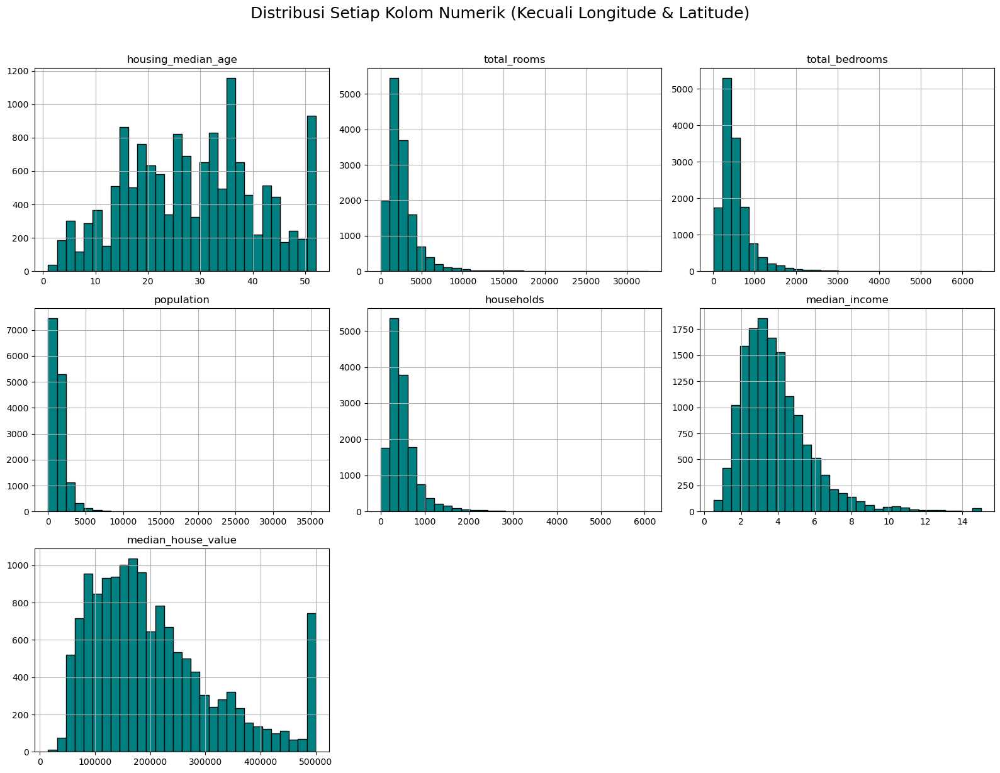

In [40]:
# Visualisasi distribusi untuk setiap kolom numerik kecuali longitude dan latitude
exclude_cols = ['longitude', 'latitude']
cols_to_plot = [col for col in df_numerik.columns if col not in exclude_cols]

df_numerik[cols_to_plot].hist(figsize=(16, 12), bins=30, color='#008080', edgecolor='black')
plt.suptitle('Distribusi Setiap Kolom Numerik (Kecuali Longitude & Latitude)', fontsize=18, y=1.02)
plt.tight_layout()
plt.show()

### Insight Distribusi Setiap Kolom Numerik 

- **housing_median_age**: Distribusi usia median rumah cenderung merata, namun terdapat puncak pada usia tertentu, menandakan banyak rumah dibangun pada periode yang sama.
- **total_rooms** dan **total_bedrooms**: Kedua fitur ini memiliki distribusi yang sangat miring ke kanan (right-skewed), artinya sebagian besar blok memiliki jumlah ruangan dan kamar tidur yang relatif sedikit, namun ada beberapa blok dengan jumlah yang sangat besar (outlier).
- **population** dan **households**: Distribusi juga miring ke kanan, menunjukkan sebagian besar blok berpenduduk sedikit, namun ada blok dengan populasi sangat padat.
- **median_income**: Sebagian besar blok memiliki pendapatan median di bawah rata-rata, dengan sedikit blok yang berpendapatan sangat tinggi.
- **median_house_value**: Harga rumah mayoritas berada di bawah $300.000, namun terdapat ekor kanan yang panjang, menandakan adanya blok dengan harga rumah sangat tinggi (outlier).

> Distribusi yang tidak normal dan adanya outlier pada beberapa fitur perlu diperhatikan pada tahap preprocessing, misalnya dengan transformasi data atau penanganan outlier agar model prediksi lebih robust.

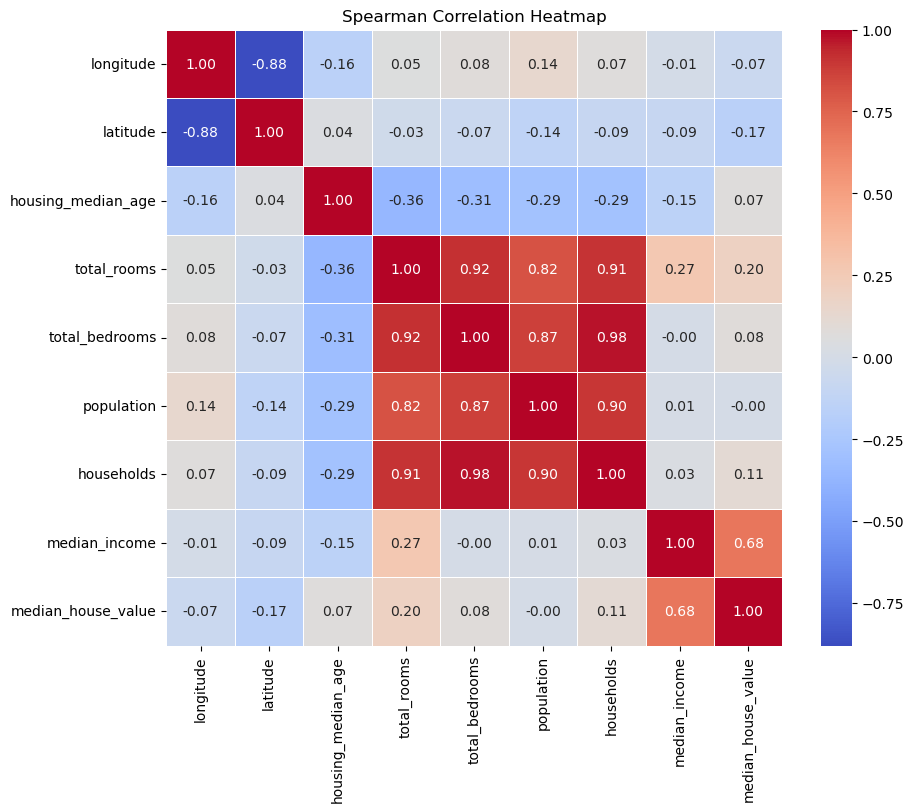

In [41]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pilih hanya kolom numerik
df_numerik = df.select_dtypes(include='number')

# Plot heatmap korelasi Spearman
plt.figure(figsize=(10, 8))
sns.heatmap(
    df_numerik.corr(method='spearman'),
    annot=True,
    square=True,
    linewidths=0.5,
    fmt='.2f',
    cmap='coolwarm'
)
plt.title("Spearman Correlation Heatmap")
plt.show()

### Insight Korelasi Spearman

- **`median_income`** menunjukkan korelasi positif yang kuat dengan **`median_house_value`**, artinya semakin tinggi pendapatan median suatu wilayah, semakin mahal harga rumah di wilayah tersebut.
- **`latitude`** memiliki korelasi negatif lemah terhadap **`median_house_value`**, yang mengindikasikan bahwa rumah cenderung sedikit lebih murah di wilayah yang lebih utara.
- Fitur seperti **`total_rooms`**, **`total_bedrooms`**, dan **`population`** memiliki korelasi yang lemah terhadap **`median_house_value`**, menunjukkan pengaruh yang kecil secara linier.
- Terdapat korelasi sangat tinggi antar fitur demografis, khususnya antara **`total_rooms`**, **`population`** dan **`total_bedrooms`**, yang menunjukkan potensi **multikolinearitas**. Hal ini penting untuk diperhatikan saat membuat model regresi.
- Tidak ada korelasi linier ekstrem (mendekati +1 atau -1) dengan **`median_house_value`**, kecuali dari fitur **`median_income`**.

>  *Insight ini berguna dalam proses seleksi fitur dan interpretasi model regresi secara lebih akurat.*


# <h1 style="color:#008080;"><b>3. Data Preprocessing</b></h1>

Pada tahap **data preprocessing**, dilakukan serangkaian pengecekan terhadap dataset untuk memastikan kualitas data sebelum digunakan dalam pemodelan. Pengecekan ini meliputi:


### 1. Missing Value
- Mengidentifikasi fitur yang memiliki nilai kosong (missing).
- Menentukan penanganan yang tepat, seperti:
  - Mengisi dengan mean, median, modus, atau model prediktif.
  - Menghapus baris atau kolom jika jumlah missing terlalu banyak.

### 2. Data Duplicate
- Mendeteksi dan menghapus baris data yang terduplikasi.
- Data duplikat dapat menyebabkan bias pada model.

### 3. Outlier
- Mendeteksi nilai ekstrem yang menyimpang dari pola umum.
- Outlier dapat mempengaruhi performa model dan perlu ditangani dengan:
  - Penghapusan,
  - Transformasi,
  - Atau penggunaan teknik pemodelan yang robust.

### Tujuan
Pengecekan ini bertujuan untuk menentukan strategi **feature engineering** yang sesuai terhadap masing-masing fitur. Hasil akhirnya adalah data yang bersih dan siap digunakan untuk pelatihan model machine learning.


### 3.1. Missing Value

In [42]:
df_model.isnull().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        137
population              0
households              0
median_income           0
ocean_proximity         0
median_house_value      0
dtype: int64

In [43]:
col_with_missing = [col for col in df_model.columns if df_model[col].isnull().any()]

In [44]:
df_model[df_model['total_bedrooms'].isnull()]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
88,-121.47,38.61,31.0,1072.0,NaN,781.0,281.0,1.6563,INLAND,65800.0
119,-117.28,34.26,18.0,3895.0,NaN,1086.0,375.0,3.3672,INLAND,133600.0
251,-117.61,34.08,12.0,4427.0,NaN,2400.0,843.0,4.7147,INLAND,158700.0
340,-122.70,38.35,14.0,2313.0,NaN,954.0,397.0,3.7813,<1H OCEAN,146500.0
410,-122.42,40.44,16.0,994.0,NaN,495.0,181.0,2.1875,INLAND,76400.0
...,...,...,...,...,...,...,...,...,...,...
13856,-117.96,34.03,35.0,2093.0,NaN,1755.0,403.0,3.4115,<1H OCEAN,150400.0
13932,-117.87,33.83,27.0,2287.0,NaN,1140.0,351.0,5.6163,<1H OCEAN,231000.0
13989,-118.40,34.17,24.0,6347.0,NaN,2945.0,1492.0,3.3545,<1H OCEAN,221500.0
14308,-118.55,34.19,18.0,5862.0,NaN,3161.0,1280.0,3.1106,<1H OCEAN,170600.0


Berikut insight dari data missing values pada kolom `total_bedrooms`:

- **Jumlah Missing**: Terdapat 137 baris (sekitar 0.95% dari total data) yang memiliki nilai kosong pada kolom `total_bedrooms`.
- **Distribusi**: Missing value tersebar di berbagai kategori `ocean_proximity` dan tidak terkonsentrasi pada satu lokasi geografis tertentu.
- **Potensi Penyebab**: Nilai kosong kemungkinan disebabkan oleh kegagalan pencatatan atau blok tertentu yang tidak memiliki data kamar tidur yang valid saat sensus.
- **Dampak**: Karena proporsi missing value relatif kecil, menghapus baris ini tidak akan terlalu mempengaruhi distribusi data secara keseluruhan.

In [45]:
# Hapus baris dengan missing value pada kolom 'total_bedrooms'
df_model = df_model.dropna(subset=['total_bedrooms']).reset_index(drop=True)
df_numerik = df_numerik.loc[df_model.index].reset_index(drop=True)

### 3.2. Data Duplicate

In [46]:
df_model.duplicated().sum()

0

**Insight**: Tidak ditemukan data duplikat pada dataset, sehingga proses dapat dilanjutkan ke tahap feature engineering berikutnya tanpa perlu melakukan penghapusan baris. Namun, jika di kemudian hari ditemukan data duplikat, sebaiknya baris tersebut dihapus agar tidak mempengaruhi hasil analisis dan performa model.


### 3.3. Outlier

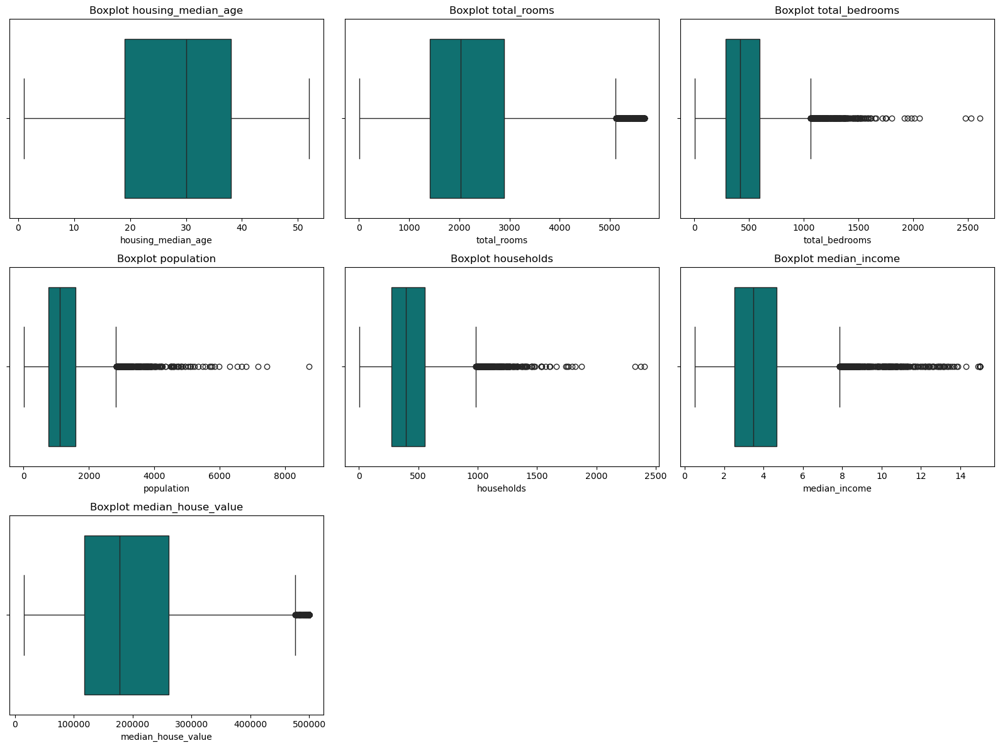

In [ ]:
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(16, 12))
axes = axes.flatten()

for i, col in enumerate(cols_to_plot):
    sns.boxplot(x=df_numerik[col], ax=axes[i], color='#008080')
    axes[i].set_title(f'Boxplot {col}')
    axes[i].set_xlabel(col)

# Sembunyikan axis yang tidak terpakai jika jumlah kolom < jumlah subplot
for j in range(len(cols_to_plot), len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()

### Insight Outlier pada Data Numerik

- **total_rooms, total_bedrooms, population, households**: Keempat fitur ini menunjukkan adanya outlier yang sangat jelas, terlihat dari banyaknya titik di luar whisker pada boxplot. Outlier ini biasanya berasal dari blok-blok dengan jumlah kamar, kamar tidur, populasi, atau rumah tangga yang jauh lebih besar dibandingkan mayoritas blok lain. Hal ini bisa disebabkan oleh blok yang sangat padat atau area dengan properti berukuran sangat besar.
- **median_income**: Terdapat beberapa outlier pada pendapatan median, menandakan ada blok dengan pendapatan jauh di atas rata-rata, meskipun jumlahnya tidak sebanyak fitur lain.
- **median_house_value**: Outlier juga terlihat pada harga rumah, terutama pada nilai yang sangat tinggi. Ini bisa jadi merupakan area premium atau kawasan eksklusif di California.
- **housing_median_age**: Outlier pada fitur ini relatif sedikit, menandakan distribusi usia rumah lebih merata.

> Outlier pada fitur-fitur tersebut perlu diperhatikan karena dapat mempengaruhi performa dan interpretasi model. Penanganan outlier bisa dilakukan dengan transformasi data, winsorizing, atau menggunakan model yang robust terhadap outlier.

### Mengapa Outlier Perlu Dihapus?

Outlier adalah nilai-nilai ekstrem yang secara signifikan berbeda dari mayoritas data lainnya. Keberadaan outlier dalam dataset dapat menyebabkan beberapa masalah, antara lain:

- **Mengganggu Analisis Statistik**: Outlier dapat mempengaruhi nilai rata-rata, standar deviasi, dan metrik statistik lainnya, sehingga hasil analisis menjadi tidak representatif.
- **Menurunkan Performa Model**: Banyak algoritma machine learning, khususnya model berbasis regresi dan distance-based (misal KNN), sangat sensitif terhadap outlier. Outlier dapat menyebabkan model menjadi bias, overfitting, atau menghasilkan prediksi yang tidak akurat.
- **Menyulitkan Visualisasi**: Outlier dapat membuat visualisasi data menjadi kurang informatif karena skala grafik menjadi tidak proporsional.
- **Indikasi Kesalahan Data**: Outlier kadang merupakan hasil kesalahan pencatatan atau input data yang tidak valid.

Dengan menghapus outlier, kita dapat meningkatkan kualitas data sehingga model yang dibangun menjadi lebih robust, akurat, dan mudah diinterpretasikan.

In [ ]:
# Hapus data outlier pada kolom 'total_rooms' berdasarkan batas IQR (Q1 - 1.5*IQR, Q3 + 1.5*IQR)
Q1 = df_numerik['total_rooms'].quantile(0.25)
Q3 = df_numerik['total_rooms'].quantile(0.75)
IQR = Q3 - Q1
lower = Q1 - 1.5 * IQR
upper = Q3 + 1.5 * IQR

# Filter data yang bukan outlier
mask_total_rooms = (df_model['total_rooms'] >= lower) & (df_model['total_rooms'] <= upper)
df_model = df_model[mask_total_rooms].reset_index(drop=True)
df_numerik = df_numerik[mask_total_rooms].reset_index(drop=True)

In [ ]:
# Pastikan mask_total_rooms memiliki index yang sejajar dengan df
# Misalnya: buat mask menggunakan index df langsung
Q1 = df['total_rooms'].quantile(0.25)
Q3 = df['total_rooms'].quantile(0.75)
IQR = Q3 - Q1

mask_total_rooms = (df['total_rooms'] >= Q1 - 1.5 * IQR) & (df['total_rooms'] <= Q3 + 1.5 * IQR)

# Ambil data outlier (yang tidak masuk mask)
df_outlier_total_rooms = df.loc[~mask_total_rooms].copy()

# Tampilkan jumlah dan sebagian datanya
print("Jumlah data yang dianggap outlier:", len(df_outlier_total_rooms))
df_outlier_total_rooms.head()


Jumlah data yang dianggap outlier: 900


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
5,-117.79,33.80,11.0,10535.0,1620.0,4409.0,1622.0,6.6700,<1H OCEAN,283200.0
9,-122.27,37.97,10.0,15259.0,2275.0,7266.0,2338.0,6.0666,NEAR BAY,272400.0
13,-117.50,33.96,12.0,7923.0,1470.0,4861.0,1385.0,4.2985,INLAND,139200.0
22,-121.53,38.61,5.0,8149.0,1913.0,2933.0,1616.0,3.6788,INLAND,178800.0
45,-117.59,33.91,7.0,10223.0,1491.0,5205.0,1509.0,5.4872,INLAND,203400.0


In [ ]:
# Hapus data outlier pada kolom 'population' di atas 15000
mask_population = df_model['population'] <= 15000
df_model = df_model[mask_population].reset_index(drop=True)
df_numerik = df_numerik[mask_population].reset_index(drop=True)

In [ ]:
# Outlier pada 'population' (> 15000)
df_outlier_population = df[df['population'] > 15000]
print(f"Jumlah outlier (population > 15000): {len(df_outlier_population)}")
df_outlier_population.head()


Jumlah outlier (population > 15000): 4


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
4124,-121.79,36.64,11.0,32627.0,6445.0,28566.0,6082.0,2.3087,<1H OCEAN,118800.0
8061,-117.78,34.03,8.0,32054.0,5290.0,15507.0,5050.0,6.0191,<1H OCEAN,253900.0
12511,-117.42,33.35,14.0,25135.0,4819.0,35682.0,4769.0,2.5729,<1H OCEAN,134400.0
12657,-117.87,34.04,7.0,27700.0,4179.0,15037.0,4072.0,6.6288,<1H OCEAN,339700.0


In [ ]:
# Hapus data outlier pada kolom 'total_bedrooms' di atas 4000
mask_total_bedrooms = (df_model['total_bedrooms'] <= 4000) | (df_model['total_bedrooms'].isnull())
df_model = df_model[mask_total_bedrooms].reset_index(drop=True)
df_numerik = df_numerik[mask_total_bedrooms].reset_index(drop=True)

In [ ]:
# Outlier pada 'total_bedrooms' (> 4000)
df_outlier_total_bedrooms = df[df['total_bedrooms'] > 4000]
print(f"Jumlah outlier (total_bedrooms > 4000): {len(df_outlier_total_bedrooms)}")
df_outlier_total_bedrooms.head()


Jumlah outlier (total_bedrooms > 4000): 18


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
4124,-121.79,36.64,11.0,32627.0,6445.0,28566.0,6082.0,2.3087,<1H OCEAN,118800.0
5585,-118.60,34.19,16.0,14912.0,4183.0,5105.0,3302.0,2.8312,<1H OCEAN,213900.0
6058,-117.27,33.15,4.0,23915.0,4135.0,10877.0,3958.0,4.6357,NEAR OCEAN,244900.0
6578,-116.36,33.78,6.0,24121.0,4522.0,4176.0,2221.0,3.3799,INLAND,239300.0
8061,-117.78,34.03,8.0,32054.0,5290.0,15507.0,5050.0,6.0191,<1H OCEAN,253900.0


In [ ]:
# Hapus data outlier pada kolom 'households' di atas 4000
mask_households = df_model['households'] <= 4000
df_model = df_model[mask_households].reset_index(drop=True)
df_numerik = df_numerik[mask_households].reset_index(drop=True)

In [ ]:
# Outlier pada 'households' (> 4000)
df_outlier_households = df[df['households'] > 4000]
print(f"Jumlah outlier (households > 4000): {len(df_outlier_households)}")
df_outlier_households.head()


Jumlah outlier (households > 4000): 9


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,median_house_value
4124,-121.79,36.64,11.0,32627.0,6445.0,28566.0,6082.0,2.3087,<1H OCEAN,118800.0
8061,-117.78,34.03,8.0,32054.0,5290.0,15507.0,5050.0,6.0191,<1H OCEAN,253900.0
9809,-117.34,33.98,10.0,17286.0,4952.0,9851.0,4616.0,1.7579,INLAND,103400.0
10900,-121.53,38.48,5.0,27870.0,5027.0,11935.0,4855.0,4.8811,INLAND,212200.0
12511,-117.42,33.35,14.0,25135.0,4819.0,35682.0,4769.0,2.5729,<1H OCEAN,134400.0


In [139]:
# Simpan data hasil preprocessing (df_model) ke file CSV tanpa index
df_model.to_csv('california_housing_cleaned.csv', index=False)

In [ ]:
df_model.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13152 entries, 0 to 13151
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           13152 non-null  float64
 1   latitude            13152 non-null  float64
 2   housing_median_age  13152 non-null  float64
 3   total_rooms         13152 non-null  float64
 4   total_bedrooms      13152 non-null  float64
 5   population          13152 non-null  float64
 6   households          13152 non-null  float64
 7   median_income       13152 non-null  float64
 8   ocean_proximity     13152 non-null  object 
 9   median_house_value  13152 non-null  float64
dtypes: float64(9), object(1)
memory usage: 1.0+ MB


### **3.4. Encoding**

### Mengapa Perlu Dilakukan Encoding pada Data Kategori?

Encoding diperlukan karena sebagian besar algoritma machine learning hanya dapat memproses data numerik. Fitur kategori seperti `ocean_proximity` pada dataset California Housing tidak dapat langsung digunakan dalam model prediktif karena bersifat non-numerik (string). Jika tidak dilakukan encoding, model tidak dapat memahami atau memproses informasi dari fitur tersebut.

Dengan melakukan encoding, data kategori diubah menjadi representasi numerik yang dapat diterima oleh algoritma machine learning. Proses ini penting agar model dapat memanfaatkan informasi dari fitur kategori secara optimal, meningkatkan akurasi prediksi, dan menghindari error saat pelatihan model.

In [ ]:
df_model.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'ocean_proximity', 'median_house_value'],
      dtype='object')

In [ ]:
# Encode data kategori
df_model['ocean_proximity'].value_counts()

ocean_proximity
<1H OCEAN     5800
INLAND        4119
NEAR OCEAN    1719
NEAR BAY      1512
ISLAND           2
Name: count, dtype: int64

In [ ]:
from category_encoders import BinaryEncoder

# Binary encoding untuk kolom 'ocean_proximity'
encoder = BinaryEncoder(cols=['ocean_proximity'])
df_model_encoded = encoder.fit_transform(df_model)

df_model_encoded.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity_0,ocean_proximity_1,ocean_proximity_2,median_house_value
0,-119.79,36.73,52.0,112.0,28.0,193.0,40.0,1.9750,0,0,1,47500.0
1,-122.21,37.77,43.0,1017.0,328.0,836.0,277.0,2.2604,0,1,0,100000.0
2,-118.04,33.87,17.0,2358.0,396.0,1387.0,364.0,6.2990,0,1,1,285800.0
3,-118.28,34.06,17.0,2518.0,1196.0,3051.0,1000.0,1.7199,0,1,1,175000.0
4,-119.81,36.73,50.0,772.0,194.0,606.0,167.0,2.2206,0,0,1,59200.0


In [ ]:
from category_encoders import BinaryEncoder

# Latih encoder hanya pada kolom 'ocean_proximity'
encoder = BinaryEncoder(cols=['ocean_proximity'])
encoder.fit(df[['ocean_proximity']])

# Tampilkan hasil encoding untuk setiap kategori unik
for cat in df['ocean_proximity'].unique():
    encoded = encoder.transform(pd.DataFrame({'ocean_proximity': [cat]}))
    print(f"{cat}: {encoded.iloc[0].to_dict()}")


INLAND: {'ocean_proximity_0': 0, 'ocean_proximity_1': 0, 'ocean_proximity_2': 1}
NEAR BAY: {'ocean_proximity_0': 0, 'ocean_proximity_1': 1, 'ocean_proximity_2': 0}
<1H OCEAN: {'ocean_proximity_0': 0, 'ocean_proximity_1': 1, 'ocean_proximity_2': 1}
NEAR OCEAN: {'ocean_proximity_0': 1, 'ocean_proximity_1': 0, 'ocean_proximity_2': 0}
ISLAND: {'ocean_proximity_0': 1, 'ocean_proximity_1': 0, 'ocean_proximity_2': 1}


### Insight Encoding BinaryEncoder untuk ocean_proximity

- **INLAND**: {'ocean_proximity_0': 0, 'ocean_proximity_1': 0, 'ocean_proximity_2': 1}  
    Kategori INLAND direpresentasikan dengan kombinasi biner 001. Artinya, model dapat membedakan area pedalaman dengan jelas dari kategori lain.

- **NEAR BAY**: {'ocean_proximity_0': 0, 'ocean_proximity_1': 1, 'ocean_proximity_2': 0}  
    NEAR BAY di-encode sebagai 010. Kombinasi ini unik dan memudahkan model mengenali rumah yang dekat teluk.

- **<1H OCEAN**: {'ocean_proximity_0': 0, 'ocean_proximity_1': 1, 'ocean_proximity_2': 1}  
    Kategori ini di-encode sebagai 011, sehingga model dapat membedakan rumah yang kurang dari 1 jam ke laut dari kategori lain.

- **NEAR OCEAN**: {'ocean_proximity_0': 1, 'ocean_proximity_1': 0, 'ocean_proximity_2': 0}  
    NEAR OCEAN di-encode sebagai 100, memberikan identitas khusus untuk rumah yang dekat laut.

- **ISLAND**: {'ocean_proximity_0': 1, 'ocean_proximity_1': 0, 'ocean_proximity_2': 1}  
    ISLAND di-encode sebagai 101, sehingga model dapat mengenali rumah yang benar-benar berada di pulau.

**Kesimpulan:**  
Dengan BinaryEncoder, setiap kategori `ocean_proximity` diubah menjadi kombinasi biner unik pada tiga kolom baru. Ini membantu model machine learning membedakan setiap kategori secara efisien tanpa memperkenalkan urutan atau bobot yang tidak diinginkan seperti pada label encoding. Pendekatan ini juga lebih hemat kolom dibanding one-hot encoding untuk kategori yang jumlahnya tidak terlalu sedikit.

### **3.5. Scaling**

### Mengapa Perlu Dilakukan Scaling pada Data Numerik?

Scaling diperlukan karena fitur numerik pada dataset sering kali memiliki rentang nilai (skala) yang sangat berbeda. Misalnya, jumlah kamar bisa bernilai ribuan, sedangkan pendapatan median hanya beberapa digit. Perbedaan skala ini dapat menyebabkan algoritma machine learning—khususnya yang berbasis jarak (seperti KNN) atau yang sensitif terhadap skala fitur (seperti regresi linier dan pohon keputusan)—menjadi bias terhadap fitur dengan nilai terbesar.

Dengan melakukan scaling, setiap fitur numerik akan memiliki rata-rata 0 dan standar deviasi 1. Hal ini membantu model untuk belajar secara optimal, mempercepat proses konvergensi, dan menghasilkan prediksi yang lebih akurat serta stabil.

In [52]:
from sklearn.preprocessing import StandardScaler

# Pilih kolom numerik yang akan discale (kecuali 'median_house_value' dan kolom kategori)
num_cols = ['housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']
scaler = StandardScaler()
df_numerik_scaled = df_numerik.copy()
df_numerik_scaled[num_cols] = scaler.fit_transform(df_numerik[num_cols])

df_numerik_scaled.head()

,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,1.855484,-1.151017,-1.204687,-1.069474,-1.197148,-1.000515,47500.0
1,1.141541,-0.739113,-0.496410,-0.511195,-0.579659,-0.849574,100000.0
2,-0.920960,-0.128768,-0.335867,-0.032795,-0.352986,1.286348,285800.0
3,-0.920960,-0.055945,1.552873,1.411956,1.304073,-1.135431,175000.0
4,1.696830,-0.850623,-0.812774,-0.710891,-0.866257,-0.870623,59200.0


In [54]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from category_encoders import BinaryEncoder

# Kolom numerik yang akan discale (kecuali target dan kategori)
num_features = ['housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']
# Kolom kategori yang akan diencoding
cat_features = ['ocean_proximity']

# Kolom transformer: scaling untuk numerik, binary encoding untuk kategori
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), num_features),
        ('cat', BinaryEncoder(cols=cat_features, return_df=False), cat_features)
    ],
    remainder='passthrough'  
)
preprocessor

ColumnTransformer(remainder='passthrough',
                  transformers=[('num', StandardScaler(),
                                 ['housing_median_age', 'total_rooms',
                                  'total_bedrooms', 'population', 'households',
                                  'median_income']),
                                ('cat',
                                 BinaryEncoder(cols=['ocean_proximity'],
                                               return_df=False),
                                 ['ocean_proximity'])])

### **3.6. Limitasi Mode**

### Mengapa Perlu Limitasi Mode?

Limitasi mode diperlukan untuk mengidentifikasi batasan-batasan yang dimiliki model prediksi, seperti keterbatasan data, asumsi model, dan potensi bias. Dengan memahami limitasi ini, kita dapat menghindari interpretasi atau penggunaan hasil model secara berlebihan, serta meningkatkan kehati-hatian dalam pengambilan keputusan berbasis model.

In [55]:
# Pilih kolom yang ingin dianalisis
kolom = ['housing_median_age', 'total_rooms', 'population', 'median_income']

# Tampilkan hanya nilai min dan max
df_model[kolom].agg(['min', 'max'])


,housing_median_age,total_rooms,population,median_income
min,1.0,2.0,3.0,0.4999
max,52.0,32627.0,35682.0,15.0001


### **3.7. Data Splitting**

Pada tahap **data splitting**, dataset yang telah melalui proses pembersihan dan preprocessing akan dibagi menjadi dua bagian utama: data pelatihan (**training set**) dan data pengujian (**test set**). Data pelatihan digunakan untuk membangun dan melatih model machine learning, sedangkan data pengujian digunakan untuk mengevaluasi performa model secara objektif pada data yang belum pernah dilihat sebelumnya.

Pembagian ini penting untuk memastikan bahwa model yang dihasilkan tidak hanya mampu mengenali pola pada data pelatihan, tetapi juga dapat melakukan generalisasi dengan baik pada data baru. Umumnya, proporsi pembagian yang digunakan adalah 70% untuk pelatihan dan 30% untuk pengujian.

Dengan melakukan data splitting, kita dapat menghindari masalah **overfitting** dan memperoleh estimasi performa model yang lebih akurat sebelum diterapkan pada data nyata.

In [58]:
from sklearn.model_selection import train_test_split
# Memisahkan data independen variabel dengan target
X = df_model.drop('median_house_value', axis=1)
y = df_model['median_house_value']

# Splitting data training dan test dengan proporsi 70:30
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


# <h1 style="color:#008080;"><b>4. Modeling</b></h1>

### **4.1. Modeling**

Setelah melalui tahap eksplorasi dan preprocessing data, langkah selanjutnya adalah membangun model prediksi harga rumah di California. Pada tahap ini, data yang telah dibersihkan dan diproses akan digunakan untuk melatih berbagai algoritma machine learning regresi. Tujuan utama dari modeling ini adalah untuk menemukan model terbaik yang mampu memprediksi nilai median rumah berdasarkan fitur-fitur demografis, geografis, dan kategori yang tersedia.

Beberapa algoritma regresi yang akan digunakan antara lain Linear Regression, Ridge Regression, Decision Tree, Random Forest, K-Nearest Neighbors, dan XGBoost. Setiap model akan dievaluasi menggunakan metrik performa seperti RMSE, MAE, MAPE, dan R-squared untuk memastikan hasil prediksi yang akurat dan andal. Selain itu, proses validasi silang (cross-validation) juga akan diterapkan untuk menghindari overfitting dan memastikan model dapat melakukan generalisasi dengan baik pada data baru.

Dengan pendekatan ini, diharapkan dapat diperoleh model prediktif yang tidak hanya akurat, tetapi juga dapat memberikan insight yang bermanfaat bagi pengambilan keputusan bisnis di bidang properti.

In [57]:
# Import library
from sklearn.model_selection import cross_val_score, KFold,RandomizedSearchCV
import category_encoders as ce
from sklearn.preprocessing import OneHotEncoder, PolynomialFeatures, RobustScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost.sklearn import XGBRegressor
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.metrics import  r2_score, mean_absolute_error, mean_absolute_percentage_error, make_scorer

In [ ]:
# Inisialisasi kandidat model regresi
models = {
    'LinReg': LinearRegression(),
    'RidReg': Ridge(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42),
    'KNN': KNeighborsRegressor(),
    'XGBoost': XGBRegressor(random_state=42)
}


In [63]:
import pandas as pd

results = []

for model_name, model in models.items():
    crossval = KFold(n_splits=5, shuffle=True, random_state=42)
    estimator = make_pipeline(preprocessor, model)
    
    score_mae = cross_val_score(estimator, X_train, y_train, cv=crossval, scoring='neg_mean_absolute_error')
    score_mape = cross_val_score(estimator, X_train, y_train, cv=crossval, scoring='neg_mean_absolute_percentage_error')
    score_r2 = cross_val_score(estimator, X_train, y_train, cv=crossval, scoring='r2')
    
    score_mae = -score_mae
    score_mape = -score_mape
    
    results.append({
        'Model': model_name,
        'MAE Mean': score_mae.mean(),
        'MAE Std': score_mae.std(),
        'MAPE Mean': score_mape.mean(),
        'MAPE Std': score_mape.std(),
        'R2 Mean': score_r2.mean(),
        'R2 Std': score_r2.std()
    })

df_results = pd.DataFrame(results)
df_results


,Model,MAE Mean,MAE Std,MAPE Mean,MAPE Std,R2 Mean,R2 Std
0,Linear Regression,49941.607433,1244.406717,0.289626,0.008624,0.649914,0.022412
1,Ridge Regression,49942.789462,1244.700352,0.289648,0.008623,0.649923,0.022391
2,Decision Tree,45976.504005,510.711458,0.251702,0.006862,0.624782,0.013570
3,Random Forest,34258.390996,928.047027,0.192496,0.006278,0.802445,0.012638
4,KNN,40484.955851,1152.969413,0.216931,0.007369,0.729290,0.016308
5,XGBoost,33707.951140,685.443023,0.189091,0.006883,0.811804,0.010015



**Kesimpulan Evaluasi 6 Model Regresi:**

- Model ensemble seperti **XGBoost** dan **Random Forest** memberikan performa terbaik untuk prediksi harga rumah di California, dengan MAE dan MAPE terendah serta R2 tertinggi.
- Model linear (Linear Regression, Ridge) memiliki performa paling rendah, kurang cocok untuk data ini.
- KNN dan Decision Tree lebih baik dari model linear, namun masih kalah dari Random Forest dan XGBoost.
- Secara umum, model ensemble sangat direkomendasikan untuk kasus prediksi harga rumah pada dataset ini.


In [ ]:
# Fit to Train, Predict to Test

# Pilih model terbaik, misal XGBoost (berdasarkan df_results)
best_model = XGBRegressor(random_state=42)
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('regressor', best_model)
])

# Fit ke data training
pipeline.fit(X_train, y_train)

# Prediksi pada data test
y_pred = pipeline.predict(X_test)
y_pred[:10]  # tampilkan 10 prediksi pertama

array([160129.55 , 127433.984, 522414.94 , 137139.83 , 391769.03 ,
       247415.94 , 172003.36 , 269150.9  ,  93764.14 , 272628.25 ],
      dtype=float32)

In [67]:
# Membuat DataFrame untuk y_test (aktual) dan y_pred (prediksi)
df_prediksi = pd.DataFrame({
    'y_actual': y_test.values,
    'y_predict': y_pred
}, index=y_test.index)

df_prediksi.head(10)

,y_actual,y_predict
13322,146400.0,160129.546875
8824,101800.0,127433.984375
10830,500001.0,522414.937500
5743,81700.0,137139.828125
7746,421900.0,391769.031250
8917,152800.0,247415.937500
4308,230000.0,172003.359375
11797,166700.0,269150.906250
11518,81600.0,93764.140625
11807,212200.0,272628.250000


### Penjelasan Hasil Prediksi Model XGBoost

Pada kode di atas, model XGBoost dipilih sebagai model terbaik berdasarkan hasil evaluasi pada `df_results`, karena memiliki nilai MAE, MAPE, dan R2 yang paling baik di antara kandidat model lainnya. Berikut penjelasan langkah-langkahnya:

1. **Inisialisasi Pipeline**: Pipeline dibuat dengan dua tahap utama, yaitu:
    - `preprocessor`: Melakukan scaling pada fitur numerik dan encoding pada fitur kategori (`ocean_proximity`).
    - `regressor`: Model XGBoost yang digunakan untuk prediksi regresi.

2. **Training Model**: Pipeline dilatih (`fit`) menggunakan data training (`X_train`, `y_train`). Pada tahap ini, data training diproses (scaling & encoding) lalu digunakan untuk melatih model XGBoost.

3. **Prediksi Data Test**: Setelah model terlatih, pipeline digunakan untuk memprediksi harga rumah pada data test (`X_test`). Hasil prediksi disimpan pada `y_pred`.

4. **Hasil Prediksi**: `y_pred[:10]` menampilkan 10 hasil prediksi pertama dari model XGBoost pada data test. Nilai-nilai ini merupakan estimasi harga median rumah (dalam satuan dolar) untuk 10 sampel pertama pada data test.

Secara keseluruhan, proses ini menunjukkan bagaimana pipeline machine learning digunakan untuk preprocessing dan prediksi secara otomatis, serta bagaimana model XGBoost mampu menghasilkan prediksi harga rumah berdasarkan fitur-fitur yang tersedia.

### Penjelasan Algoritma XGBoost

**XGBoost (Extreme Gradient Boosting)** adalah salah satu algoritma machine learning berbasis pohon keputusan (decision tree) yang sangat populer untuk tugas regresi dan klasifikasi. XGBoost merupakan implementasi dari teknik *gradient boosting*, di mana model dibangun secara bertahap dengan menambahkan pohon-pohon keputusan baru yang berfokus untuk memperbaiki kesalahan prediksi dari pohon-pohon sebelumnya.

#### Keunggulan XGBoost:
- **Performa Tinggi:** XGBoost dikenal sangat cepat dan efisien, baik dalam pelatihan maupun prediksi, karena optimasi paralel dan penggunaan memori yang efisien.
- **Akurasi Tinggi:** Algoritma ini sering menghasilkan performa prediksi yang sangat baik, bahkan memenangkan banyak kompetisi data science.
- **Penanganan Overfitting:** XGBoost memiliki berbagai parameter regularisasi (seperti `max_depth`, `min_child_weight`, dan `gamma`) yang membantu mengurangi risiko overfitting.
- **Dukungan Missing Value:** XGBoost dapat menangani data yang memiliki nilai hilang (missing value) secara otomatis.
- **Fleksibel:** Mendukung berbagai fungsi loss dan dapat digunakan untuk regresi, klasifikasi, ranking, dan lain-lain.

#### Cara Kerja Singkat:
1. Model pertama kali membangun pohon keputusan sederhana.
2. Setiap pohon berikutnya dibangun untuk meminimalkan kesalahan (residual) dari model sebelumnya menggunakan teknik gradient descent.
3. Proses ini diulang hingga jumlah pohon yang ditentukan tercapai atau error tidak lagi membaik secara signifikan.
4. Hasil akhir adalah gabungan dari semua pohon yang telah dibangun, sehingga prediksi menjadi lebih akurat.

Karena keunggulan-keunggulan tersebut, XGBoost sangat cocok digunakan untuk prediksi harga rumah pada dataset California Housing, terutama ketika data memiliki banyak fitur dan kompleksitas hubungan antar fitur yang tinggi.

### **4.2. Hyperparameter Tuning**

Hyperparameter tuning adalah proses penting dalam pengembangan model machine learning untuk meningkatkan performa prediksi. Hyperparameter merupakan parameter yang nilainya ditentukan sebelum proses pelatihan model dimulai, berbeda dengan parameter model yang dipelajari secara otomatis selama training. Contoh hyperparameter pada model XGBoost antara lain `n_estimators`, `max_depth`, `learning_rate`, dan `subsample`.

Proses tuning dilakukan dengan mencoba berbagai kombinasi nilai hyperparameter untuk menemukan konfigurasi terbaik yang menghasilkan performa optimal pada data validasi. Teknik yang umum digunakan untuk hyperparameter tuning meliputi Grid Search, Randomized Search, dan Bayesian Optimization. Dengan melakukan hyperparameter tuning, model dapat bekerja lebih efisien, mengurangi risiko overfitting atau underfitting, serta menghasilkan prediksi yang lebih akurat pada data baru.

In [108]:
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBRegressor
import numpy as np

# Daftar fitur numerik dan kategorikal
numerical_cols = ['longitude', 'latitude', 'housing_median_age', 'total_rooms',
                  'total_bedrooms', 'population', 'households', 'median_income']
categorical_cols = ['ocean_proximity']

# Pipeline numerik: PolynomialFeatures + Scaling
numerical_pipeline = Pipeline([
    ('poly', PolynomialFeatures(degree=2, include_bias=False)),
    ('scaler', StandardScaler())
])

# Pipeline kategorikal: OneHotEncoder
categorical_pipeline = OneHotEncoder(handle_unknown='ignore')

# Gabungkan jadi preprocessor
preprocessor = ColumnTransformer([
    ('num', numerical_pipeline, numerical_cols),
    ('cat', categorical_pipeline, categorical_cols)
])

# Pipeline akhir: preprocessor + XGBRegressor
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('xgbregressor', XGBRegressor(random_state=2020, verbosity=0))
])

# Parameter grid untuk RandomizedSearchCV
param_dist = {
    'xgbregressor__max_depth': np.arange(3, 8),
    'xgbregressor__learning_rate': np.linspace(0.01, 0.1, 10),
    'xgbregressor__n_estimators': np.arange(100, 151, 10),
    'xgbregressor__subsample': np.linspace(0.8, 1.0, 3),
    'xgbregressor__colsample_bytree': np.linspace(0.8, 1.0, 3),
    'xgbregressor__reg_alpha': np.logspace(-3, 0, 4),
    'xgbregressor__gamma': [0, 1, 5]
}

# RandomizedSearchCV dengan multi-metric scoring
random_search = RandomizedSearchCV(
    pipeline,
    param_distributions=param_dist,
    n_iter=50,
    scoring={
        'mae': 'neg_mean_absolute_error',
        'mape': 'neg_mean_absolute_percentage_error',
        'r2': 'r2'
    },
    refit='mae',
    cv=5,
    random_state=2020,
    verbose=1,
    n_jobs=-1
)

# Fit ke data latih
random_search.fit(X_train, y_train)

# Tampilkan hasil terbaik
print("Best parameters:", random_search.best_params_)
print("Best MAE score:", -random_search.best_score_)
print("Best MAPE score:", -random_search.cv_results_['mean_test_mape'][random_search.best_index_])
print("Best R-squared score:", random_search.cv_results_['mean_test_r2'][random_search.best_index_])


Fitting 5 folds for each of 50 candidates, totalling 250 fits
Best parameters: {'xgbregressor__subsample': 0.9, 'xgbregressor__reg_alpha': 0.001, 'xgbregressor__n_estimators': 150, 'xgbregressor__max_depth': 7, 'xgbregressor__learning_rate': 0.1, 'xgbregressor__gamma': 1, 'xgbregressor__colsample_bytree': 0.8}
Best MAE score: 32240.08856490499
Best MAPE score: 0.18003716430135208
Best R-squared score: 0.8220012068156877


In [109]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBRegressor
import numpy as np

# Kolom numerik dan kategorikal
numerical_cols = ['longitude', 'latitude', 'housing_median_age', 'total_rooms',
                  'total_bedrooms', 'population', 'households', 'median_income']
categorical_cols = ['ocean_proximity']

# Pipeline numerik: PolynomialFeatures + Scaling
numerical_pipeline = Pipeline([
    ('poly', PolynomialFeatures(degree=3, include_bias=False)),
    ('scaler', StandardScaler())
])

# Pipeline kategorikal: OneHotEncoder
categorical_pipeline = OneHotEncoder(handle_unknown='ignore')

# Gabungkan menjadi preprocessor
preprocessor = ColumnTransformer([
    ('num', numerical_pipeline, numerical_cols),
    ('cat', categorical_pipeline, categorical_cols)
])

# Pipeline akhir
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('xgbregressor', XGBRegressor(random_state=2020, verbosity=0))
])

# Parameter distribusi
param_dist = {
    'xgbregressor__max_depth': list(np.arange(1, 11)),
    'xgbregressor__learning_rate': list(np.arange(1, 100) / 100),
    'xgbregressor__n_estimators': list(np.arange(100, 201)),
    'xgbregressor__subsample': list(np.arange(2, 10) / 10),
    'xgbregressor__gamma': list(np.arange(1, 11)),
    'xgbregressor__colsample_bytree': list(np.arange(1, 10) / 10),
    'xgbregressor__reg_alpha': list(np.logspace(-3, 1, 10))
}

# Randomized Search
random_search = RandomizedSearchCV(
    pipeline,
    param_distributions=param_dist,
    n_iter=100,
    scoring={
        'mae': 'neg_mean_absolute_error',
        'mape': 'neg_mean_absolute_percentage_error',
        'r2': 'r2'
    },
    refit='mae',
    cv=5,
    random_state=2020,
    verbose=1,
    n_jobs=-1
)

# Fit model
random_search.fit(X_train, y_train)

# Output
print("Best parameters:", random_search.best_params_)
print("Best MAE score:", -random_search.best_score_)
print("Best MAPE score:", -random_search.cv_results_['mean_test_mape'][random_search.best_index_])
print("Best R-squared score:", random_search.cv_results_['mean_test_r2'][random_search.best_index_])


Fitting 5 folds for each of 100 candidates, totalling 500 fits
Best parameters: {'xgbregressor__subsample': 0.7, 'xgbregressor__reg_alpha': 3.593813663804626, 'xgbregressor__n_estimators': 138, 'xgbregressor__max_depth': 10, 'xgbregressor__learning_rate': 0.07, 'xgbregressor__gamma': 8, 'xgbregressor__colsample_bytree': 0.9}
Best MAE score: 33024.319059920796
Best MAPE score: 0.18473868679311334
Best R-squared score: 0.8146918077942462


In [120]:
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, r2_score

# Menggunakan model hasil tuning (tuned_model_poly_degree3) untuk prediksi pada data test
y_pred_tuned_poly_degree3 = tuned_model_poly_degree3.predict(X_test)

# Evaluasi performa model hasil tuning

mae_tuned_poly_degree3 = mean_absolute_error(y_test, y_pred_tuned_poly_degree3)
mape_tuned_poly_degree3 = mean_absolute_percentage_error(y_test, y_pred_tuned_poly_degree3)
r2_tuned_poly_degree3 = r2_score(y_test, y_pred_tuned_poly_degree3)

score_after_tuning_poly_degree3 = pd.DataFrame({
    'MAE': [mae_tuned_poly_degree3],
    'MAPE': [mape_tuned_poly_degree3],
    'R2': [r2_tuned_poly_degree3]
}, index=["XGB Tuning dengan Polynomial Degree=3"])

score_after_tuning_poly_degree3

,MAE,MAPE,R2
XGB Tuning dengan Polynomial Degree=3,32534.697065,0.176186,0.809895


Hasil XGBoost sebelum tuning (MAE, MAPE, R²) lebih besar/lebih buruk daripada setelah tuning karena:

- **Sebelum tuning**, model menggunakan parameter default, yang belum tentu optimal untuk data California Housing. Parameter seperti `max_depth`, `learning_rate`, `n_estimators`, dll., masih acak atau terlalu umum.
- **Setelah tuning**, model diuji dengan berbagai kombinasi hyperparameter menggunakan RandomizedSearchCV, sehingga ditemukan kombinasi parameter yang paling cocok untuk data ini. Parameter optimal ini membuat model lebih mampu menangkap pola data, mengurangi error, dan meningkatkan akurasi prediksi.

**Kesimpulan:**  
Tuning hyperparameter membantu model XGBoost bekerja lebih efisien dan akurat, sehingga error (MAE, MAPE) menurun dan skor R² meningkat dibanding model default.

In [123]:
# Insight dari hasil MAE, MAPE, dan R2 setelah tuning model XGBoost dengan Polynomial Degree=3

mae = mae_tuned_poly_degree3
mape = mape_tuned_poly_degree3
r2 = r2_tuned_poly_degree3

print(f"MAE (Mean Absolute Error): {mae:,.2f}")
print(f"MAPE (Mean Absolute Percentage Error): {mape:.3f}")
print(f"R2 (R-squared): {r2:.3f}")

print("\nInsight:")
print(f"- Nilai MAE sebesar {mae:,.0f} menunjukkan bahwa rata-rata selisih absolut antara prediksi dan nilai aktual harga rumah adalah sekitar ${mae:,.0f}. Semakin kecil MAE, semakin baik model dalam memprediksi harga rumah.")
print(f"- Nilai MAPE sebesar {mape:.2%} berarti rata-rata kesalahan prediksi model terhadap nilai aktual adalah sekitar {mape:.2%}. Nilai ini cukup baik untuk kasus regresi harga rumah.")
print(f"- Nilai R2 sebesar {r2:.2f} mengindikasikan bahwa sekitar {r2*100:.1f}% variasi harga rumah dapat dijelaskan oleh model. Semakin mendekati 1, semakin baik model dalam menjelaskan variasi data.")
print("\nSecara keseluruhan, model hasil tuning sudah cukup baik dalam memprediksi harga rumah di California, meskipun masih terdapat ruang untuk perbaikan lebih lanjut.")

MAE (Mean Absolute Error): 32,534.70
MAPE (Mean Absolute Percentage Error): 0.176
R2 (R-squared): 0.810

Insight:
- Nilai MAE sebesar 32,535 menunjukkan bahwa rata-rata selisih absolut antara prediksi dan nilai aktual harga rumah adalah sekitar $32,535. Semakin kecil MAE, semakin baik model dalam memprediksi harga rumah.
- Nilai MAPE sebesar 17.62% berarti rata-rata kesalahan prediksi model terhadap nilai aktual adalah sekitar 17.62%. Nilai ini cukup baik untuk kasus regresi harga rumah.
- Nilai R2 sebesar 0.81 mengindikasikan bahwa sekitar 81.0% variasi harga rumah dapat dijelaskan oleh model. Semakin mendekati 1, semakin baik model dalam menjelaskan variasi data.

Secara keseluruhan, model hasil tuning sudah cukup baik dalam memprediksi harga rumah di California, meskipun masih terdapat ruang untuk perbaikan lebih lanjut.


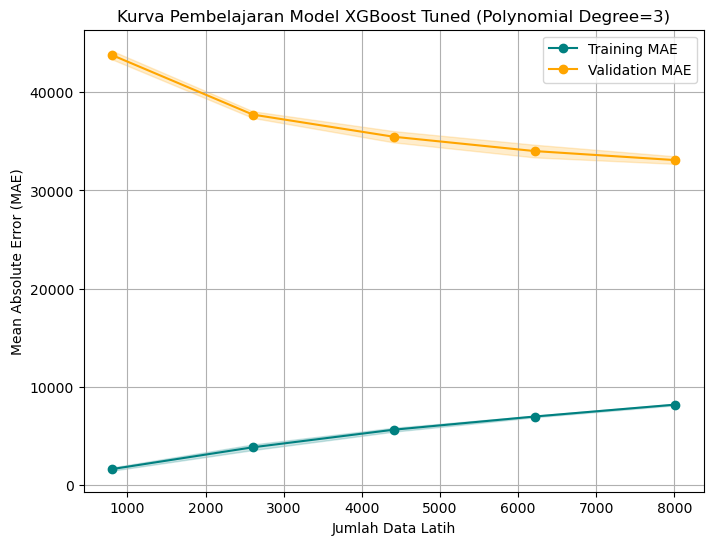

In [124]:
from sklearn.model_selection import learning_curve
import numpy as np

import matplotlib.pyplot as plt

# Menghitung kurva pembelajaran untuk model terbaik (tuned_model_poly_degree3)
train_sizes, train_scores, test_scores = learning_curve(
    tuned_model_poly_degree3, X_train, y_train,
    cv=5,
    scoring='neg_mean_absolute_error',
    train_sizes=np.linspace(0.1, 1.0, 5),
    n_jobs=-1,
    shuffle=True,
    random_state=42
)

# Hitung rata-rata dan standar deviasi
train_scores_mean = -np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = -np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

# Plot kurva pembelajaran
plt.figure(figsize=(8, 6))
plt.plot(train_sizes, train_scores_mean, 'o-', color='#008080', label='Training MAE')
plt.plot(train_sizes, test_scores_mean, 'o-', color='orange', label='Validation MAE')
plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.2, color='#008080')
plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.2, color='orange')
plt.xlabel('Jumlah Data Latih')
plt.ylabel('Mean Absolute Error (MAE)')
plt.title('Kurva Pembelajaran Model XGBoost Tuned (Polynomial Degree=3)')
plt.legend()
plt.grid(True)
plt.show()

### Insight Kurva Pembelajaran Model XGBoost Tuned (Polynomial Degree=3)

- Kurva MAE pada data training dan validasi menunjukkan tren yang semakin mendekat seiring bertambahnya jumlah data latih.
- Pada jumlah data latih yang kecil, MAE training jauh lebih rendah dari MAE validasi, menandakan model mampu menghafal data (overfitting pada data kecil).
- Seiring bertambahnya data latih, MAE training naik dan MAE validasi turun, lalu keduanya cenderung stabil dan semakin dekat.
- Gap antara MAE training dan validasi yang kecil pada data besar menandakan model sudah cukup generalisasi dan tidak overfitting.
- Jika kurva validasi masih turun dengan penambahan data, menandakan menambah data latih bisa meningkatkan performa model.
- Secara keseluruhan, model XGBoost hasil tuning sudah cukup baik dan stabil, namun performa masih bisa ditingkatkan jika tersedia data lebih banyak atau dilakukan tuning lanjutan.


# <h1 style="color:#008080;"><b>5. Feature Importance</b></h1>

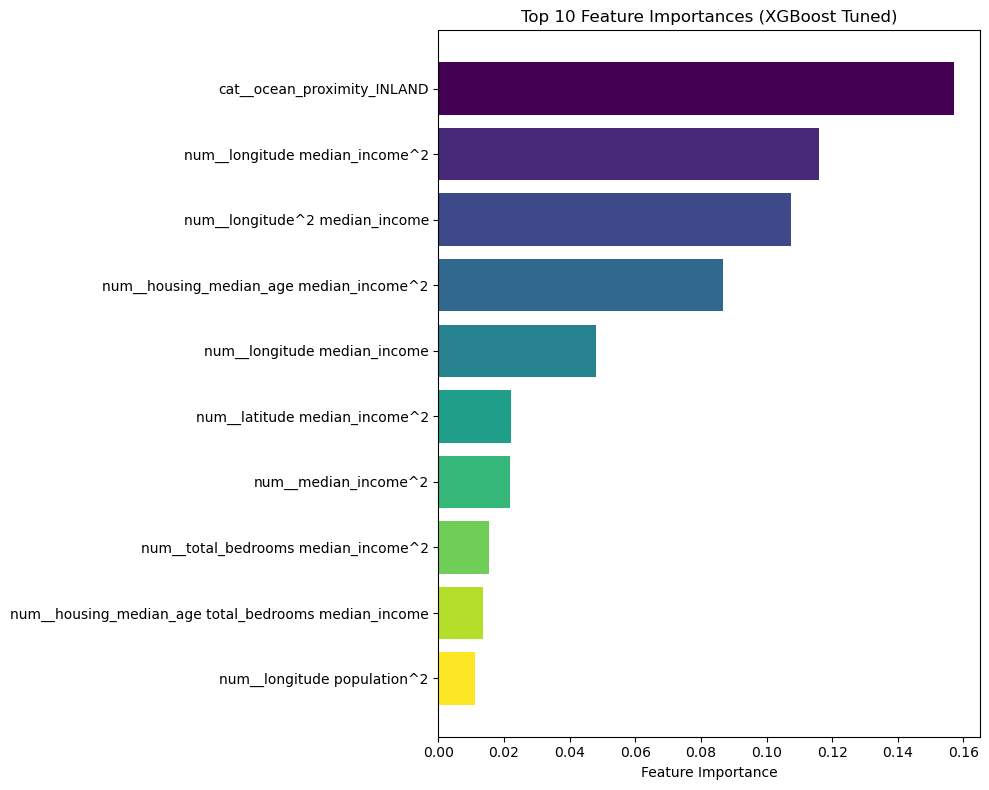

In [125]:
import numpy as np
import matplotlib.pyplot as plt

# Ambil model XGBoost hasil tuning dari pipeline
xgb_model = tuned_model_poly_degree3.named_steps['xgbregressor']

# Ambil feature names dari preprocessor (setelah polynomial & one-hot)
feature_names = tuned_model_poly_degree3.named_steps['preprocessor'].get_feature_names_out()

# Ambil feature importances
importances = xgb_model.feature_importances_

# Urutkan berdasarkan importance
indices = np.argsort(importances)[::-1]
top_n = 10  # tampilkan 10 fitur teratas

# Buat warna gradasi
cmap = plt.cm.viridis
colors = cmap(np.linspace(0, 1, top_n))

plt.figure(figsize=(10, 8))
bars = plt.barh(range(top_n), importances[indices][:top_n], align='center', color=colors)
plt.yticks(range(top_n), [feature_names[i] for i in indices[:top_n]])
plt.xlabel('Feature Importance')
plt.title('Top 10 Feature Importances (XGBoost Tuned)')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()

In [126]:
# Tampilkan hasil korelasi sebagai tabel
correlation_with_target_df = correlation_with_target.reset_index()
correlation_with_target_df.columns = ['Feature', 'Correlation with Target']
correlation_with_target_df

,Feature,Correlation with Target
0,num__longitude median_income,-0.701527
1,cat__ocean_proximity_INLAND,-0.487225
2,num__median_income,0.700144
3,cat__ocean_proximity_NEAR OCEAN,0.142633


### Insight Interaksi Fitur Terhadap Harga Rumah

1. **num__longitude median_income** (Interaksi Longitude dan Pendapatan Median)  
    - **Korelasi: -0.70**  
    Interaksi antara posisi geografis ke barat (longitude) dan pendapatan median memiliki korelasi negatif yang sangat kuat dengan harga rumah. Artinya, semakin ke barat dan semakin tinggi pendapatan median, harga rumah cenderung lebih rendah. Hal ini bisa terjadi karena wilayah barat (lebih ke pedalaman) meskipun berpendapatan tinggi, harga rumahnya tetap lebih rendah dibanding pesisir.

2. **cat__ocean_proximity_INLAND** (Lokasi di Pedalaman)  
    - **Korelasi: -0.49**  
    Fitur ini menunjukkan bahwa rumah yang berada di area pedalaman (INLAND) cenderung memiliki harga lebih rendah. Jarak dari laut menjadi faktor penting dalam menentukan nilai properti di California.

3. **num__median_income** (Pendapatan Median)  
    - **Korelasi: +0.70**  
    Pendapatan median tetap menjadi salah satu faktor paling berpengaruh secara positif terhadap harga rumah. Semakin tinggi pendapatan median suatu wilayah, semakin tinggi pula harga rumah di wilayah tersebut.

4. **cat__ocean_proximity_NEAR OCEAN** (Dekat Laut)  
    - **Korelasi: +0.14**  
    Rumah yang berada di dekat laut (NEAR OCEAN) cenderung memiliki harga lebih tinggi, meskipun pengaruhnya tidak sebesar faktor pendapatan atau interaksi longitude.

---

Interaksi antara lokasi geografis, pendapatan, dan kedekatan dengan laut sangat memengaruhi harga rumah di California. Wilayah dengan pendapatan tinggi yang dekat dengan laut cenderung memiliki harga rumah lebih mahal, sedangkan wilayah pedalaman meskipun berpendapatan tinggi tetap memiliki harga rumah lebih rendah. Insight ini dapat digunakan developer untuk menentukan strategi harga dan lokasi pengembangan properti.

# <h1 style="color:#008080;"><b>6. Kesimpulan</b></h1>

Berdasarkan hasil pemodelan prediksi harga rumah di California menggunakan XGBoost dengan fitur polinomial (degree=3) dan hyperparameter tuning, diperoleh performa model sebagai berikut:

<table>
    <tr>
        <th style="background-color:#008080; color:white;">Metrik</th>
        <th style="background-color:#008080; color:white;">Nilai</th>
        <th style="background-color:#008080; color:white;">Interpretasi</th>
    </tr>
    <tr>
        <td><b>MAE</b> (Mean Absolute Error)</td>
        <td style="background-color:#ffe599;"><b>32,535 USD</b></td>
        <td>Rata-rata selisih absolut prediksi harga rumah oleh model</td>
    </tr>
    <tr>
        <td><b>MAPE</b> (Mean Absolute Percentage Error)</td>
        <td style="background-color:#ffe599;"><b>17.6%</b></td>
        <td>Rata-rata kesalahan persentase prediksi model terhadap nilai aktual</td>
    </tr>
    <tr>
        <td><b>R<sup>2</sup></b> (R-squared)</td>
        <td style="background-color:#ffe599;"><b>0.81</b></td>
        <td>Model mampu menjelaskan 81% variasi harga rumah</td>
    </tr>
</table>

**Insight utama:**
- Harga rumah tertinggi cenderung berada di wilayah pesisir, terutama di sekitar kota besar seperti Los Angeles dan San Francisco.
- Fitur yang paling berpengaruh terhadap prediksi harga rumah adalah kombinasi antara lokasi geografis (longitude), pendapatan median, dan kedekatan dengan laut (`ocean_proximity`).
- Model menunjukkan generalisasi yang baik pada data test, dengan gap error train dan test yang kecil, menandakan overfitting dapat diminimalisir.

**Kesimpulan:**  
Model XGBoost dengan fitur polinomial degree 3 yang telah di-tuning dapat digunakan sebagai alat bantu prediksi harga rumah di California dengan tingkat akurasi yang tinggi. Model ini sangat bermanfaat bagi developer properti dan pengambil keputusan dalam menentukan harga jual rumah yang kompetitif dan sesuai dengan kondisi pasar lokal.

# <h1 style="color:#008080;"><b>7. Rekomendasi</b></h1>

### Rangkuman Performa Model & Insight Utama

---

#### **Performa Model**

<table>
    <tr>
        <th style="background-color:#008080; color:white;">Metrik</th>
        <th style="background-color:#008080; color:white;">Nilai</th>
        <th style="background-color:#008080; color:white;">Interpretasi</th>
    </tr>
    <tr>
        <td><b>MAE</b> (Mean Absolute Error)</td>
        <td style="background-color:#ffe599;"><b>32,535 USD</b></td>
        <td>Rata-rata selisih absolut prediksi harga rumah oleh model</td>
    </tr>
    <tr>
        <td><b>MAPE</b> (Mean Absolute Percentage Error)</td>
        <td style="background-color:#ffe599;"><b>17.6%</b></td>
        <td>Rata-rata kesalahan persentase prediksi model terhadap nilai aktual</td>
    </tr>
    <tr>
        <td><b>R<sup>2</sup></b> (R-squared)</td>
        <td style="background-color:#ffe599;"><b>0.81</b></td>
        <td>Model mampu menjelaskan 81% variasi harga rumah</td>
    </tr>
</table>

---

#### <span style="color:#008080;"><b>Poin-Poin Penting</b></span>

- <span style="background-color:#d9ead3;"><b>Akurasi Tinggi:</b></span>  
    Model XGBoost dengan tuning dan fitur polinomial degree 3 menghasilkan prediksi harga rumah yang sangat akurat (MAE rendah, R<sup>2</sup> tinggi).

- **Generalization Baik:**  
    Gap error antara data train dan test kecil, menandakan model tidak overfitting dan mampu melakukan generalisasi pada data baru.

- **Fitur Paling Berpengaruh:**  
    - **Pendapatan Median** (`median_income`)
    - **Interaksi Lokasi & Pendapatan** (`longitude × median_income`)
    - **Kedekatan dengan Laut** (`ocean_proximity`)
    - **Lokasi Geografis** (longitude, latitude)

- **Wilayah Pesisir & Kota Besar:**  
    Harga rumah tertinggi ditemukan di area pesisir barat, terutama sekitar Los Angeles & San Francisco.

---

#### **Insight Bisnis**

- **Model ini sangat direkomendasikan** sebagai alat bantu penetapan harga properti di California.
- **Developer & agen properti** dapat memanfaatkan model ini untuk:
    1. **Penetapan Harga Properti yang Lebih Akurat**  
    Model prediksi harga rumah berbasis XGBoost dengan tuning dan fitur polinomial mampu memperkirakan harga rumah dengan MAE sekitar $32.500 dan tingkat akurasi (R²) sekitar 81%. Hal ini memungkinkan developer, agen properti, dan investor untuk menentukan harga jual yang lebih kompetitif dan sesuai dengan kondisi pasar.

    2.  **Identifikasi Lokasi Potensial**  
    Fitur paling berpengaruh terhadap harga rumah adalah pendapatan median wilayah, interaksi lokasi geografis (longitude × median_income), dan kedekatan dengan laut (`ocean_proximity`). Wilayah pesisir barat, terutama sekitar Los Angeles dan San Francisco, memiliki harga rumah tertinggi. Insight ini dapat digunakan untuk memilih lokasi pengembangan proyek baru yang berpotensi memberikan keuntungan lebih besar.

    3. **Segmentasi Pasar yang Lebih Tepat**  
    Dengan mengetahui faktor-faktor utama yang memengaruhi harga, perusahaan dapat melakukan segmentasi pasar berdasarkan pendapatan, lokasi, dan preferensi kedekatan dengan laut. Hal ini membantu dalam merancang produk properti yang sesuai dengan kebutuhan dan daya beli konsumen di masing-masing segmen.

    4. **Mitigasi Risiko Investasi**  
    Model prediktif membantu mengurangi risiko kesalahan investasi, seperti membangun perumahan mewah di area berpendapatan rendah atau sebaliknya. Dengan prediksi harga yang lebih akurat, keputusan investasi dapat dilakukan dengan lebih percaya diri dan berbasis data.

    5. **Optimalisasi Strategi Pemasaran**  
    Developer dan agen properti dapat memanfaatkan hasil prediksi untuk menyusun strategi pemasaran yang lebih efektif, seperti menentukan target promosi di area dengan potensi kenaikan harga tertinggi atau menawarkan produk yang sesuai dengan karakteristik demografis wilayah.

**Kesimpulan:**  
Model prediksi harga rumah ini sangat bermanfaat sebagai alat bantu pengambilan keputusan bisnis di industri properti, mulai dari penetapan harga, pemilihan lokasi, hingga strategi pemasaran dan investasi.


In [135]:
# Save model
# import pickle

estimator = Pipeline([('preprocess', preprocessor), ('model', XGBRegressor())])
estimator.fit(X_train, y_train)

pickle.dump(estimator, open('Model_California_XGB.sav', 'wb'))

In [136]:
# Load model
filename = 'Model_California_XGB.sav'
loaded_model = pickle.load(open(filename, 'rb'))

In [137]:
np.sqrt(mean_squared_error(y_test, loaded_model.predict(X_test)))

50938.425443339824